# <center>Laboratorium 5<br>Metody Numeryczne</center>

Instrukcja:  
Na zajęciach należy wykonać poniższe zadania, a następnie sporządzić sprawozdanie zawierające odpowiedzi (w postaci kodu) z komentarzami w środowisku Jupyter Notebook i umieścić je na platformie e-learningowej.

***Materiały przygotowujące:***


In [1]:
import main
import numpy as np
import scipy
import matplotlib
import matplotlib.pyplot as plt

def PolyCoefficients(x, coeffs):
    """ Returns a polynomial for ``x`` values for the ``coeffs`` provided.
    The coefficients must be in ascending order (``x**0`` to ``x**o``).
    """
    o = len(coeffs)
    y = 0
    for i in range(o):
        y += coeffs[i]*x**i
    return y

***Zadanie 1.***  
Zaimplementuj interpolacje pierwszego stopnia. Jako dane wejściowe dane są dwa wektory: argumentów oraz wartości funkcji. Funkcja ma zwracać współczynniki funkcji liniowych w poszczególnych przedziałach.

***Podpowiedź***

poszczególne współczynniki przyjmują wartość:

$ a_k=\frac{y_{k+1}-y_k}{x_{k+1}-x_k}$

$ b_k=y_k-a_k*x_k$

***Przykład***


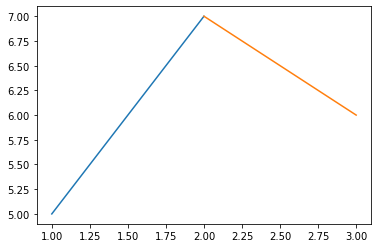

In [9]:

#Implementacja interpolacji pierwszego stopnia 

def first_spline(x: np.ndarray, y: np.ndarray):
    if type(x) is not np.ndarray or type(y) is not np.ndarray:
        return None
    if np.shape(x) != np.shape(y):
        return None
    a = np.zeros(len(x)-1)
    b = np.zeros(len(x)-1)
    for i in range(0,len(x)-1):
        a[i]=(y[i+1]-y[i])/(x[i+1]-x[i])
        b[i]=y[i]-a[i]*x[i]
    return a,b

x=np.array([1,2,3])
y=np.array([5,7,6])

a,b=first_spline(x,y)
f = [[b[i],a[i]] for i in range(len(a))]
for i in range(len(x)-1):
    x_new = np.linspace(x[i], x[i+1],1000)
    plt.plot(x_new, PolyCoefficients(x_new, f[i]))

***Zadanie 2.***  
Korzystając z funkcji z pakietu [scipy.interpolate.splprep](https://docs.scipy.org/doc/scipy/reference/generated/scipy.interpolate.splprep.html#scipy.interpolate.splprep), funkcji zaimplementowanej w Zadaniu 1 oraz interpolacji barycentrycznej z węzłami równoodległymi (korzystając z kodu z poprzedniego zadania) dokonaj interpolacji funkcji: 
    
### $ f(x) = \frac{1}{25x^2+1}$

W przedziale \[-1, 1\]

dla różnych ilości wartości węzłów: 5, 10, 15, 20, 50, 100, 1000

Dokonaj porównania wyników otrzymanych:  
Wykorzystując funkcję z ubiegłego tygodnia, ocenić jakość interpolacji funkcji spline pierwszego stopnia z wartościami danej funkcji.
Sprawdź czas wykonywania się poszczególnych elementów oraz ilość pamięci użytej 


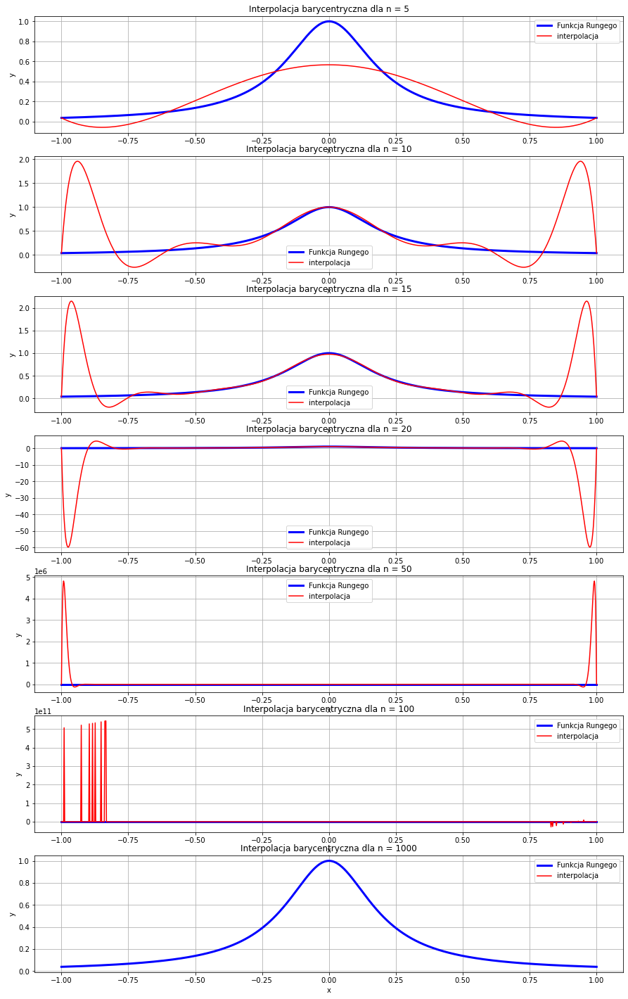

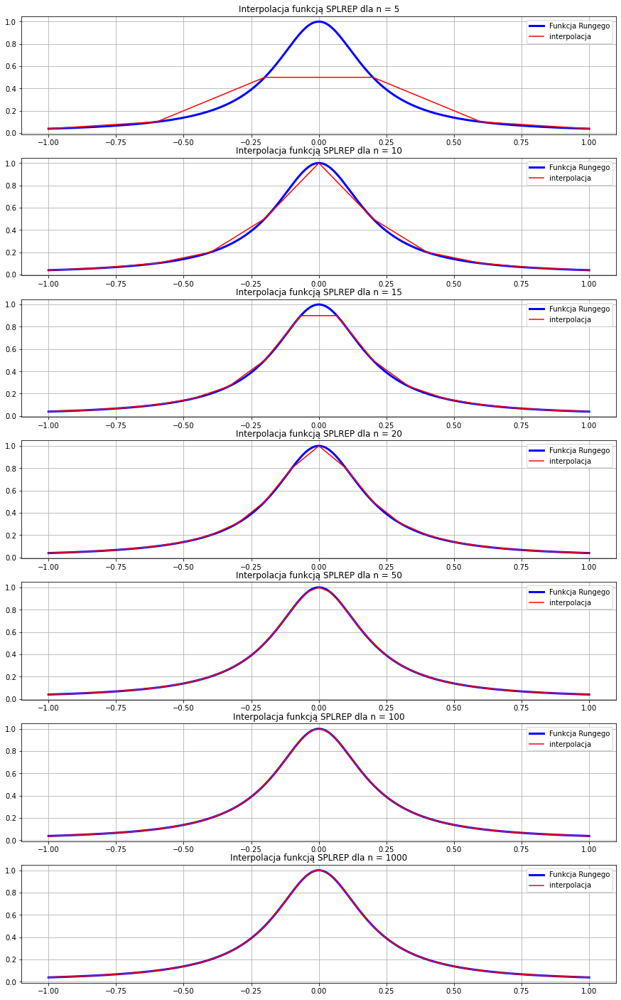

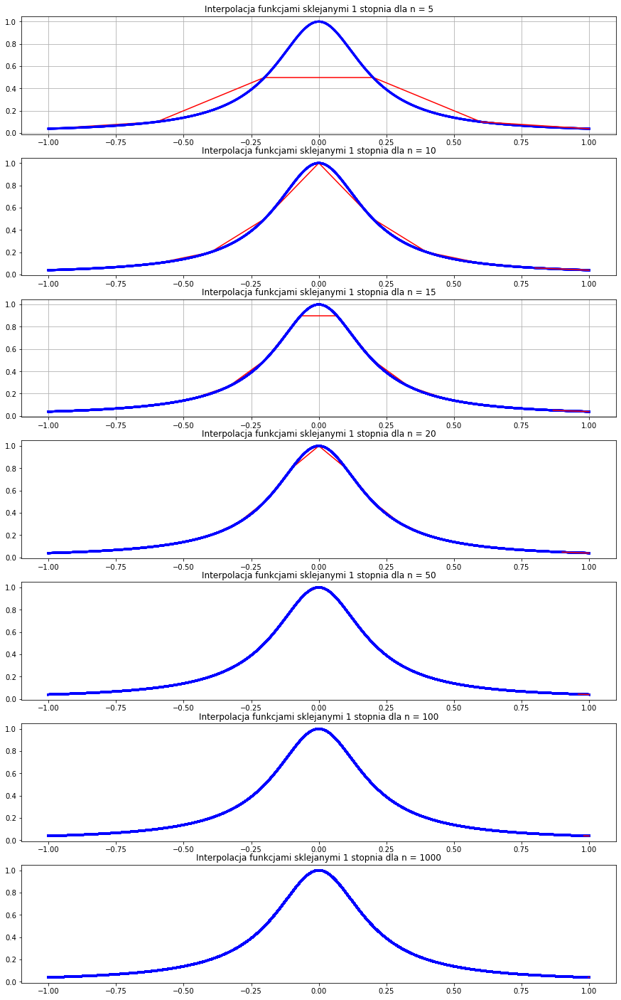

In [5]:
from scipy.interpolate import splprep, splev, splrep
from scipy.interpolate import barycentric_interpolate


def PolyCoefficients(x, coeffs):
    o = len(coeffs)
    y = 0
    for i in range(o):
        y += coeffs[i]*x**i
    return y




number_of_nodes = [5, 10, 15, 20, 50, 100, 1000]
f = lambda x: 1/(25*x**2+1)

### ANALIZA DZIAŁANIA POSZCZEGÓLNYCH FUNKCJI ###

j=0 #Zmienna przydatna do subplotowania

fig1, axs1 = plt.subplots(7,1) # Tworzę subplot dla interpolacji barycentrycznej
fig1.set_figheight(25) #Ustawiam wysokość figury subplota
fig1.set_figwidth(15) #Ustawiam szerokość figury subplota

fig2, axs2 = plt.subplots(7, 1) #Tworzę subplot dla interpolacji SPLPREP
fig2.set_figheight(25) #Ustawiam wysokość figury subplota
fig2.set_figwidth(15) #Ustawiam szerokość figury subplota

fig3, axs3 = plt.subplots(7, 1) #Tworzę subplot dla interpolacji pierwszego stopnia 
fig3.set_figheight(25) #Ustawiam wysokość figury subplota
fig3.set_figwidth(15) #Ustawiam szerokość figury subplota

for n in number_of_nodes:
    x = np.linspace(-1, 1, n+1)
    y = f(x)
    t = np.linspace(-1,1,1000)

    # INTERPOLACJA BARYCENTRYCZNA
    y_barycentric = barycentric_interpolate(x, y, t)
    axs1[j].plot(t, f(t), 'b', linewidth=3, label='Funkcja Rungego')
    axs1[j].plot(t, y_barycentric,'r',label='interpolacja')
    axs1[j].set(xlabel='x', ylabel='y',title=f'Interpolacja barycentryczna dla n = {n}')
    axs1[j].grid()
    axs1[j].legend()
    
    # INTERPOLACJA SPLPREP
    spl = splrep(x,y,k=1)
    y_spl = splev(t,spl)
    axs2[j].plot(t, f(t), 'b', linewidth=3, label='Funkcja Rungego')
    axs2[j].plot(t,y_spl,'r',label='interpolacja')
    axs2[j].set(title = f"Interpolacja funkcją SPLREP dla n = {n}")
    axs2[j].grid()
    axs2[j].legend()

    
    ## INTERPOLACJA PIERWSZEGO STOPNIA
    a_first, b_first = first_spline(x,y)
    coeffs = [[b_first[i],a_first[i]] for i in range(len(a_first))]
    for i in range(len(x)-1):
        x_new = np.linspace(x[i], x[i+1],1000)
        axs3[j].plot(t, f(t), 'b', linewidth=3)
        axs3[j].plot(x_new, PolyCoefficients(x_new, coeffs[i]),'r')
        axs3[j].set(title = f"Interpolacja funkcjami sklejanymi 1 stopnia dla n = {n}")
        axs3[j].grid()
    j=j+1


WNIOSKI: Jeśli wykorzystamy interpolację barycentryczną, występuje tak zwany efekt Rungego. Nie jest to większym zaskoczeniem, ponieważ z wykładu wiem, że funkcja, którą próbowaliśmy interpolować jest typowym przykładem funkcji, która zmaga się z proglemem Rungego. Jak widać, dla n = 1000 funkcja z pakietu Scipy przestaje działać i nie interpoluje wcale. Mogliśmy to także obserować robiąc poprzednie sprawozdania.

Dla interpolacji zaimplementowanej przez nas oraz za pomocą funkcji SPLREP wyniki są bardzo podobne. Dla n>20 funkcja już bardzo dobrze interpoluje, dopasowuje się do zadanej krzywej z coraz większą wartośćią n. Dla n = 1000 gołym okiem ciężko spostrzec różnice pomiędzy naszą interpolacją a prawdziwą funkcją.







Sprawdzam złożoność czasową oraz potrzebną pamięć w zależności od n:

11.6 µs ± 421 ns per loop (mean ± std. dev. of 5 runs, 10 loops each)


Memory usage for first spline: 
peak memory: 279.12 MiB, increment: 0.15 MiB
26.5 µs ± 397 ns per loop (mean ± std. dev. of 5 runs, 10 loops each)


Memory usage for first spline: 
peak memory: 279.12 MiB, increment: 0.00 MiB
27.8 µs ± 524 ns per loop (mean ± std. dev. of 5 runs, 10 loops each)


Memory usage for first spline: 
peak memory: 279.12 MiB, increment: 0.00 MiB
49.2 µs ± 1.16 µs per loop (mean ± std. dev. of 5 runs, 10 loops each)


Memory usage for first spline: 
peak memory: 279.12 MiB, increment: 0.00 MiB
85.3 µs ± 402 ns per loop (mean ± std. dev. of 5 runs, 10 loops each)


Memory usage for first spline: 
peak memory: 279.12 MiB, increment: 0.00 MiB
167 µs ± 1.9 µs per loop (mean ± std. dev. of 5 runs, 10 loops each)


Memory usage for first spline: 
peak memory: 279.12 MiB, increment: 0.01 MiB
1.63 ms ± 14.9 µs per loop (mean ± std. dev. of 5 runs, 10 loops each)


Memory usage for first spline: 
p

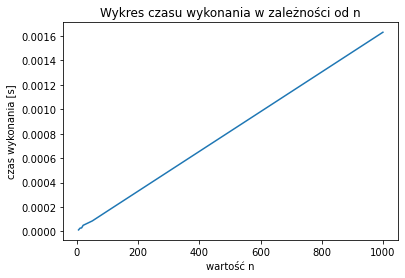

In [6]:
%load_ext memory_profiler

time_vector =list()
dev_vector=list()
number_of_nodes = [5, 10, 15, 20, 50, 100, 1000]
f = lambda x: 1/(25*x**2+1)
for n in number_of_nodes:
    x = np.linspace(-1, 1, n+1)
    y = f(x)
    f_spl_timing = %timeit -r 5 -n 10 -o first_spline(x,y)
    time_vector.append(f_spl_timing.average)   # średni czas próby
    dev_vector.append(f_spl_timing.stdev)     # odchylenie standardowe
    print('\n\nMemory usage for first spline: ')
    %memit first_spline(x,y) #możemy zaobserować, że użycie pamięci jest niezależne od n
 


fig, ax1 = plt.subplots()
ax1.plot(number_of_nodes,time_vector)
ax1.set(title="Wykres czasu wykonania w zależności od n",xlabel='wartość n',ylabel='czas wykonania [s]') #wykres jest liniowy, można więc założyć, że złożoność obliczeniowa algorytmu jest także liniowa O(n)
fig.show()

Jak widać, złożoność czasowa naszego algorytmu jest liniowa.
Wartość potrzebnej pamięci nie zależy od n.

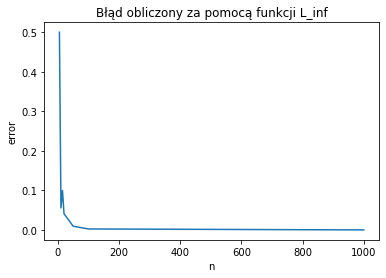

In [8]:
from typing import Union, List

def L_inf(xr:Union[int, float, List, np.ndarray],x:Union[int, float, List, np.ndarray])-> float:
    if type(xr) not in [int, float, list, np.ndarray] or type(x) not in [int, float, list, np.ndarray]: #ważne żeby było list a nie List bo to konkretny rodzaj z List
        return np.nan
    if type(x) is int and type(xr) is list:
        return np.nan 
    if type(xr) is int and type(x) is list:
        return np.nan  
    if type(x) is list and type(xr) is list:
        if len(x) == len(xr):
            return max([abs(x[i] - xr[i]) for i in range(len(x))])
        else: 
            return np.nan
    if type(x) is np.ndarray and type(xr) is np.ndarray and x.shape != xr.shape:
            return np.nan
    if type(x) is int and type(xr) is int:
        return abs(x-xr)
    if type(x) is int and type(xr) is np.ndarray or type(xr) is int and type(x) is np.ndarray: # ale w sumie dlaczego xd?
        return np.nan
    return max(abs(x-xr))

f1 = lambda x: 1/(25*x**2+1)
number_of_nodes = [5, 10, 15, 20, 50, 100, 1000]
errors = list()
for k in number_of_nodes:
    x = np.linspace(-1, 1, k+1)
    y = f1(x)
    a,b=main.first_spline(x,y)
    f = [[b[i],a[i]] for i in range(len(a))]
    y_new = []
    for i in range(len(x)-1):
        x_new = np.linspace(x[i], x[i+1],k)
        y_new.append(PolyCoefficients(x_new, f[i]))
    M = np.asarray(y_new).reshape(-1)
    x2 = np.linspace(-1, 1, len(M))
    y2 = f1(x2)
    err = L_inf(y2,M)
    errors.append(err)

fig, ax1 = plt.subplots()
ax1.plot(number_of_nodes,errors)
ax1.set(title="Błąd obliczony za pomocą funkcji L_inf",xlabel='n',ylabel='error')
fig.show()

Można zaobserować, że dla n równego około 50 wartość błędu jest już bardzo mała.

***Zadanie 3.***  
Korzystając z funkcji z pakietu [scipy.interpolate.splprep](https://docs.scipy.org/doc/scipy/reference/generated/scipy.interpolate.splprep.html#scipy.interpolate.splprep), funkcji zaimplementowanej w Zadaniu 1 oraz interpolacji barycentrycznej z węzłami równoodległymi (korzystając z kodu z poprzedniego zadania) dokonaj interpolacji funkcji: 
    
### $ f(x) = cos(x)x^4$

W przedziale \[-1, 1\]

dla różnych ilości wartości węzłów: 5, 10, 15, 20, 50, 100, 1000

Dokonaj porównania wyników otrzymanych:  
Wykorzystując funkcję z ubiegłego tygodnia, ocenić jakość interpolacji funkcji spline pierwszego stopnia z wartościami danej funkcji.
Sprawdź czas wykonywania się poszczególnych elementów oraz ilość pamięci użytej 


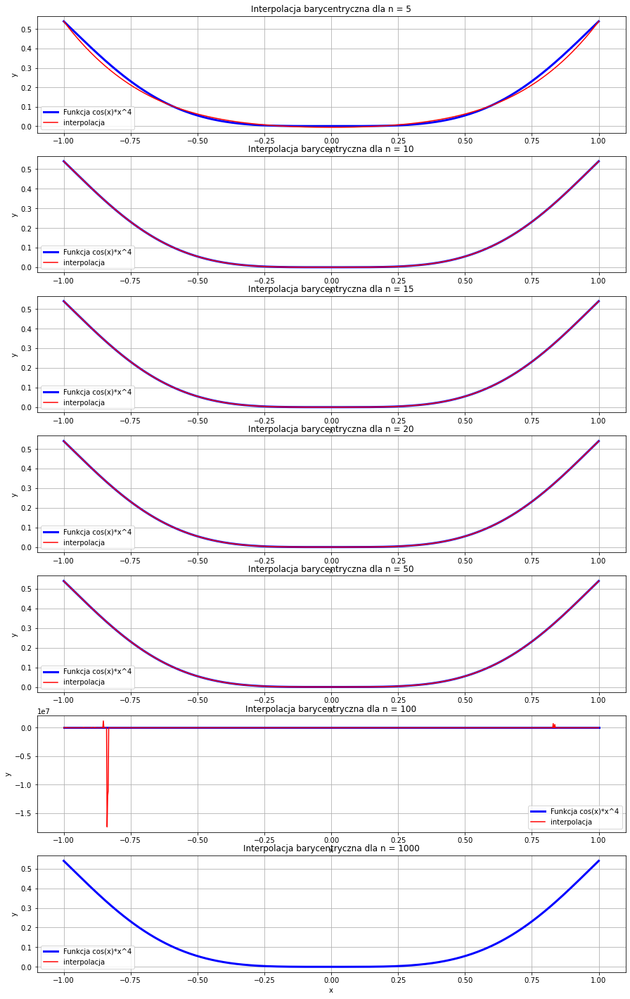

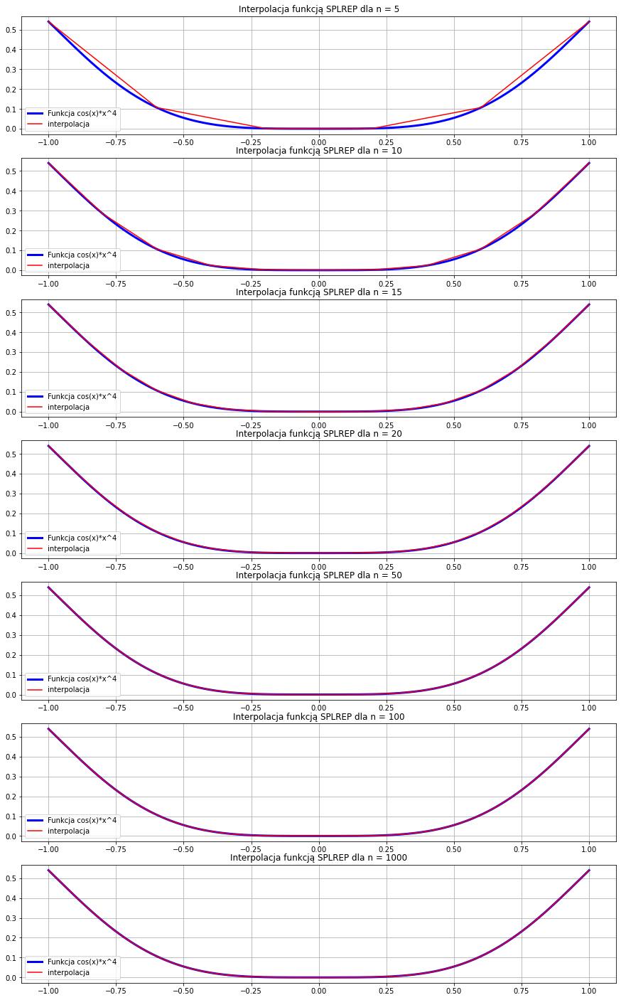

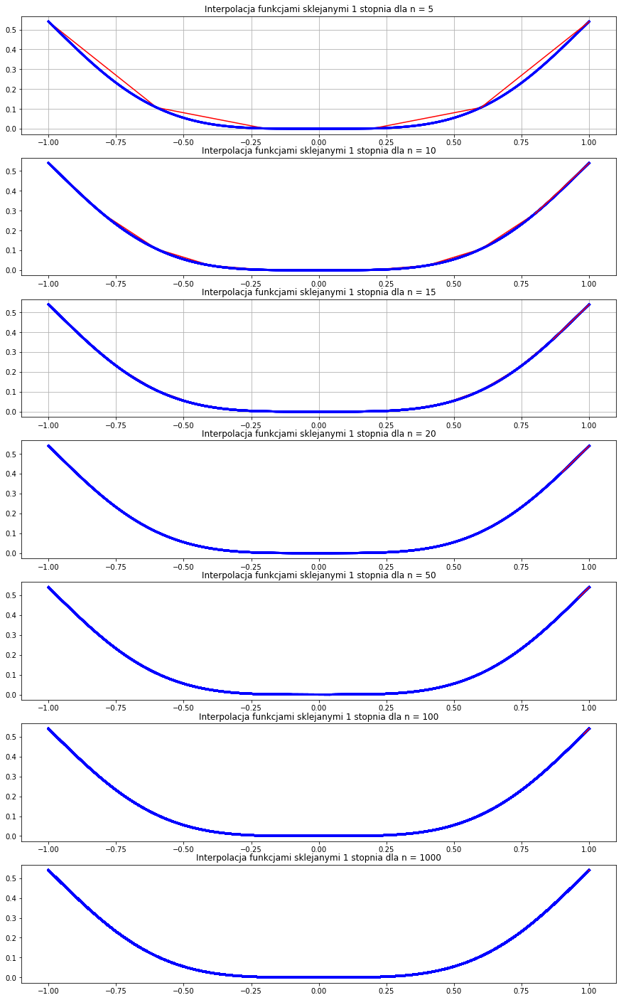

In [16]:
from scipy.interpolate import splprep
from scipy.interpolate import barycentric_interpolate


def PolyCoefficients(x, coeffs):
    o = len(coeffs)
    y = 0
    for i in range(o):
        y += coeffs[i]*x**i
    return y




number_of_nodes = [5, 10, 15, 20, 50, 100, 1000]
f = lambda x: np.cos(x)*x**4


### ANALIZA DZIAŁANIA POSZCZEGÓLNYCH FUNKCJI ###

j=0 #Zmienna przydatna do subplotowania

fig1, axs1 = plt.subplots(7,1) # Tworzę subplot dla interpolacji barycentrycznej
fig1.set_figheight(25) #Ustawiam wysokość figury subplota
fig1.set_figwidth(15) #Ustawiam szerokość figury subplota

fig2, axs2 = plt.subplots(7, 1) #Tworzę subplot dla interpolacji SPLPREP
fig2.set_figheight(25) #Ustawiam wysokość figury subplota
fig2.set_figwidth(15) #Ustawiam szerokość figury subplota

fig3, axs3 = plt.subplots(7, 1) #Tworzę subplot dla interpolacji pierwszego stopnia 
fig3.set_figheight(25) #Ustawiam wysokość figury subplota
fig3.set_figwidth(15) #Ustawiam szerokość figury subplota

for n in number_of_nodes:
    x = np.linspace(-1, 1, n+1)
    y = f(x)
    t = np.linspace(-1,1,1000)

    # INTERPOLACJA BARYCENTRYCZNA
    y_barycentric = barycentric_interpolate(x, y, t)
    axs1[j].plot(t, f(t), 'b', linewidth=3, label='Funkcja cos(x)*x^4')
    axs1[j].plot(t, y_barycentric,'r',label='interpolacja')
    axs1[j].set(xlabel='x', ylabel='y',title=f'Interpolacja barycentryczna dla n = {n}')
    axs1[j].grid()
    axs1[j].legend()
    
    # INTERPOLACJA SPLPREP
    spl = splrep(x,y,k=1)
    y_spl = splev(t,spl)
    axs2[j].plot(t, f(t), 'b', linewidth=3, label='Funkcja cos(x)*x^4')
    axs2[j].plot(t,y_spl,'r',label='interpolacja')
    axs2[j].set(title = f"Interpolacja funkcją SPLREP dla n = {n}")
    axs2[j].grid()
    axs2[j].legend()

    
    ## INTERPOLACJA PIERWSZEGO STOPNIA
    a_first, b_first = first_spline(x,y)
    coeffs = [[b_first[i],a_first[i]] for i in range(len(a_first))]
    for i in range(len(x)-1):
        x_new = np.linspace(x[i], x[i+1],1000)
        axs3[j].plot(t, f(t), 'b', linewidth=3)
        axs3[j].plot(x_new, PolyCoefficients(x_new, coeffs[i]),'r')
        axs3[j].set(title = f"Interpolacja funkcjami sklejanymi 1 stopnia dla n = {n}")
        axs3[j].grid()
    j=j+1

WNIOSKI: Gdy używamy interpolacji barycentrycznej na początku wszystko jest w porządku. Funkcja bardzo ładnie dopasowuje się do wykresu funkcji cos(x)*x^4. Dziwna rzecz dzieje się dla n=100. Niespodziewanie interpolacja psuje się, dzieje się to w okolicy wartości argumentu pi/4. Nie jestem w stanie jednak stwierdzić czym to jest spowodowane. Dla n=1000 także w tym przypadku funkcja przestaje działać, interpolacja nie jest wyświetlana. Bardzo prawdopodobne jest to, że funkcja z pakietu Scipy nie działa dla tak dużych wartości n.

W przypadku interpolacji napisanej przeze mnie oraz funkcji SPLREP interpolacja działa bardzo dobrze i podobnie do siebie.

Badam złożoność czasową oraz pamięciową:

The memory_profiler extension is already loaded. To reload it, use:
  %reload_ext memory_profiler
13.4 µs ± 2.17 µs per loop (mean ± std. dev. of 5 runs, 10 loops each)


Memory usage for first spline: 
peak memory: 362.71 MiB, increment: 0.00 MiB
20.2 µs ± 465 ns per loop (mean ± std. dev. of 5 runs, 10 loops each)


Memory usage for first spline: 
peak memory: 362.71 MiB, increment: 0.00 MiB
28.1 µs ± 322 ns per loop (mean ± std. dev. of 5 runs, 10 loops each)


Memory usage for first spline: 
peak memory: 362.71 MiB, increment: 0.00 MiB
37.3 µs ± 342 ns per loop (mean ± std. dev. of 5 runs, 10 loops each)


Memory usage for first spline: 
peak memory: 362.71 MiB, increment: 0.00 MiB
85.4 µs ± 628 ns per loop (mean ± std. dev. of 5 runs, 10 loops each)


Memory usage for first spline: 
peak memory: 362.71 MiB, increment: 0.00 MiB
175 µs ± 9.12 µs per loop (mean ± std. dev. of 5 runs, 10 loops each)


Memory usage for first spline: 
peak memory: 362.71 MiB, increment: 0.00 MiB
1.65 ms

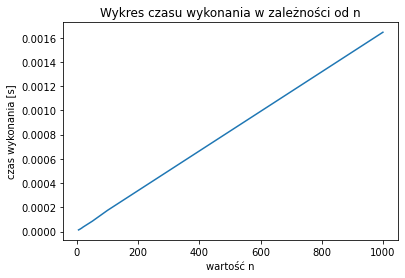

In [17]:
%load_ext memory_profiler



time_vector =list()
dev_vector=list()
number_of_nodes = [5, 10, 15, 20, 50, 100, 1000]
f = lambda x: np.cos(x)*x**4
for n in number_of_nodes:
    x = np.linspace(-1, 1, n+1)
    y = f(x)
    f_spl_timing = %timeit -r 5 -n 10 -o first_spline(x,y)
    time_vector.append(f_spl_timing.average)   # średni czas próby
    dev_vector.append(f_spl_timing.stdev)     # odchylenie standardowe
    print('\n\nMemory usage for first spline: ')
    %memit first_spline(x,y) #możemy zaobserować, że użycie pamięci jest niezależne od n
 


fig, ax1 = plt.subplots()
ax1.plot(number_of_nodes,time_vector)
ax1.set(title="Wykres czasu wykonania w zależności od n",xlabel='wartość n',ylabel='czas wykonania [s]') #wykres jest liniowy, można więc założyć, że złożoność obliczeniowa algorytmu jest także liniowa O(n)
fig.show()

Możemy wyciągać podobne wnioski jak w poprzednim zadaniu. Złożoność czasowa algorytmu jest liniowa, potrzebna pamięć nie zależy od n.


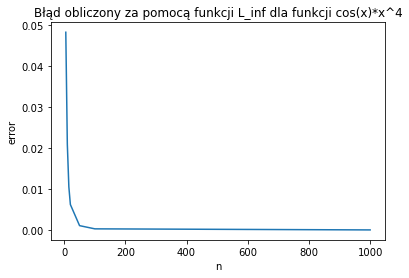

In [18]:
import matplotlib.pyplot as plt
from scipy.interpolate import splev, splrep
from typing import Union, List

def L_inf(xr:Union[int, float, List, np.ndarray],x:Union[int, float, List, np.ndarray])-> float:
    if type(xr) not in [int, float, list, np.ndarray] or type(x) not in [int, float, list, np.ndarray]: #ważne żeby było list a nie List bo to konkretny rodzaj z List
        return np.nan
    if type(x) is int and type(xr) is list:
        return np.nan 
    if type(xr) is int and type(x) is list:
        return np.nan  
    if type(x) is list and type(xr) is list:
        if len(x) == len(xr):
            return max([abs(x[i] - xr[i]) for i in range(len(x))])
        else: 
            return np.nan
    if type(x) is np.ndarray and type(xr) is np.ndarray and x.shape != xr.shape:
            return np.nan
    if type(x) is int and type(xr) is int:
        return abs(x-xr)
    if type(x) is int and type(xr) is np.ndarray or type(xr) is int and type(x) is np.ndarray: # ale w sumie dlaczego xd?
        return np.nan
    return max(abs(x-xr))

f1 = lambda x: np.cos(x)*x**4
number_of_nodes = [5, 10, 15, 20, 50, 100, 1000]
errors = list()
for k in number_of_nodes:
    x = np.linspace(-1, 1, k+1)
    y = f1(x)
    a,b=main.first_spline(x,y)
    f = [[b[i],a[i]] for i in range(len(a))]
    y_new = []
    for i in range(len(x)-1):
        x_new = np.linspace(x[i], x[i+1],k)
        y_new.append(PolyCoefficients(x_new, f[i]))
    M = np.asarray(y_new).reshape(-1)
    x2 = np.linspace(-1, 1, len(M))
    y2 = f1(x2)
    err = L_inf(y2,M)
    errors.append(err)

fig, ax1 = plt.subplots()
ax1.plot(number_of_nodes,errors)
ax1.set(title="Błąd obliczony za pomocą funkcji L_inf dla funkcji cos(x)*x^4",xlabel='n',ylabel='error')
fig.show()

Możemy zauważyć, że dla n równego około 50 nasza interpolacja działa już bardzo dobrze.

***Zadanie 4.***  
Zaimplementuj funkcję interpolującą sklejaną trzeciego rzędu (splajn kubiczny). Jako dane wejściowe dane są dwa wektory: argumentów oraz wartości funkcji. Funkcja ma zwracać współczynniki funkcji wielomianowych w poszczególnych przedziałach.

***Podpowiedź***

wprowadzimy następujące zmienne:

$b_0 = y_k$

$b_1 = d_k - \frac{h_k}{6}(2m_k+m_{k+1})$

$b_2 = \frac{m_k}{2}$

$b_3 = \frac{m_{k+1}-m_k}{6h_k}$

gdzie:

$h_k = x_{k+1} - x_k$

$d_k = y_{k+1} - y_k$

$m_k = 3\frac{d_k-d_{k-1}}{h_{k-1}+h_k} - \frac{m_{k-1}*\rho_k}{2}-\frac{m_{k+1}*\lambda_k}{2}$

$\lambda_k = \frac{h_k}{h_{k-1}+h_k}$

$\rho_k = \frac{h_{k-1}}{h_{k-1}+h_k}$

dzieki temi współczynniki możemy wyznaczyć w następującyu sposób:

$a_3 = b_3$

$a_2 = b_2 - 3*b_3*x_k$

$a_1 = b1 - 2*b_2*x_k + 3*b_3*x_k*x_k$

$a_0 = b_0 - b_1*x_k + b_2*x_k*x_k - b_3*x_k*x_k*x_k$

Do wyznaczenia $m_0$ oraz $m_n$ wykorzystujemy metodę ograniczeń naturalnych i przyjmujemy te wartości jako zerowe.
Jako wektor $m_k$ przyjmij początkowo zera np.zeros.

***Przykład***

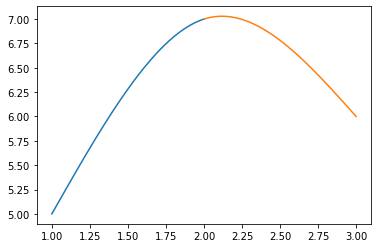

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import main
x=np.array([1,2,3])
y=np.array([5,7,6])


a0,a1,a2,a3 = main.cubic_spline(x,y)
f = [[a0[i],a1[i],a2[i],a3[i]] for i in range(len(a0))]


for i in range(len(x)-1):
    x_new = np.linspace(x[i], x[i+1],1000)
    plt.plot(x_new, PolyCoefficients(x_new, f[i]))

***Zadania 5.***  
Korzystając z funkcji z pakietu [scipy.interpolate.splprep](https://docs.scipy.org/doc/scipy/reference/generated/scipy.interpolate.splprep.html#scipy.interpolate.splprep), funkcji zaimplementowanej w Zadaniu 4: 
    
### $ f(x) = \frac{1}{25x^2+1}$

W przedziale \[-1, 1\]

dla różnych ilości wartości węzłów: 5, 10, 15, 20, 50, 100, 1000

Dokonaj porównania wyników otrzymanych:  
Wykorzystując funkcję z ubiegłego tygodnia, ocenić jakość interpolacji funkcji spline pierwszego stopnia z wartościami danej funkcji.
Sprawdź czas wykonywania się poszczególnych elementów oraz ilość pamięci użytej 


Zgodnie z zaleceniami prowadzącego w sprawozdaniu będę używał funkcji, która nie jest uproszczona, to znaczy wartość mk nie wynosi początkowo zero. Znacznie poprawi to wizualizacje danych.

In [3]:
#Nadesłana przez prowadzącego dokładna implementacja funkcji cubic_spline

from scipy.interpolate import splprep, splev, splrep
from scipy.interpolate import barycentric_interpolate


def PolyCoefficients(x, coeffs):
    o = len(coeffs)
    y = 0
    for i in range(o):
        y += coeffs[i]*x**i
    return y

import numpy as np
def cubic_spline(x, y):
    if not (isinstance(x, np.ndarray) and isinstance(y, np.ndarray)):
        return None
    if len(x.shape) != 1 or len(y.shape) != 1:
        return None
    if x.shape != y.shape:
        return None
    if len(x.shape) != 1:
        return None


    x = np.array(x)
    y = np.array(y)
    ### check if sorted
    if np.any(np.diff(x) < 0):
        idx = np.argsort(x)
        x = x[idx]
        y = y[idx]

    size = len(x)
    delta_x = np.diff(x)
    delta_y = np.diff(y)

    ### Get matrix A
    A = np.zeros(shape=(size, size))
    b = np.zeros(shape=(size, 1))
    A[0, 0] = 1
    A[-1, -1] = 1

    for i in range(1, size - 1):
        A[i, i - 1] = delta_x[i - 1]
        A[i, i + 1] = delta_x[i]
        A[i, i] = 2 * (delta_x[i - 1] + delta_x[i])
        ### Get matrix b
        b[i, 0] = 3 * (delta_y[i] / delta_x[i] - delta_y[i - 1] / delta_x[i - 1])

    ### Solves for c in Ac = b
    
    n = A.shape[0]
    xn = np.zeros(len(A))
    x_prev = np.zeros(len(A)).copy()
    tol = 1e-100
    n_iterations = 300
    counter = 0
    x_diff = tol + 1

    while (x_diff > tol) and (counter < n_iterations):  # iteration level
        for i in range(0, n):  # element wise level for x
            s = 0
            for j in range(0, n):  # summation for i !=j
                if i != j:
                    s += A[i, j] * x_prev[j]

            xn[i] = (b[i] - s) / A[i, i]
        # update values
        counter += 1
        x_diff = (np.sum((x - x_prev) ** 2)) ** 0.5
        x_prev = xn.copy() 
    c = xn

    ### Solves for d and b
    d = np.zeros(shape=(size - 1, 1))
    b = np.zeros(shape=(size - 1, 1))
    for i in range(0, len(d)):
        d[i] = (c[i + 1] - c[i]) / (3 * delta_x[i])
        b[i] = (delta_y[i] / delta_x[i]) - (delta_x[i] / 3) * (2 * c[i] + c[i + 1])

    a3 = np.zeros(len(y) - 1)
    a2 = np.zeros(len(y) - 1)
    a1 = np.zeros(len(y) - 1)
    a0 = np.zeros(len(y) - 1)
    for i in range(len(y) - 1):
        a3[i] = d[i]
        a2[i] = c[i] - 3 * d[i] * x[i]
        a1[i] = b[i] - 2 * c[i] * x[i] + 3 * d[i] * x[i] * x[i]
        a0[i] = y[i] - b[i] * x[i] + c[i] * x[i] * x[i] - d[i] * x[i] * x[i] * x[i]

    return (a0,a1,a2,a3)

Przypisuje odpowiednie wartości potrzebnym zmiennym oraz funkcji i wykonuję pierwszą część zadania.

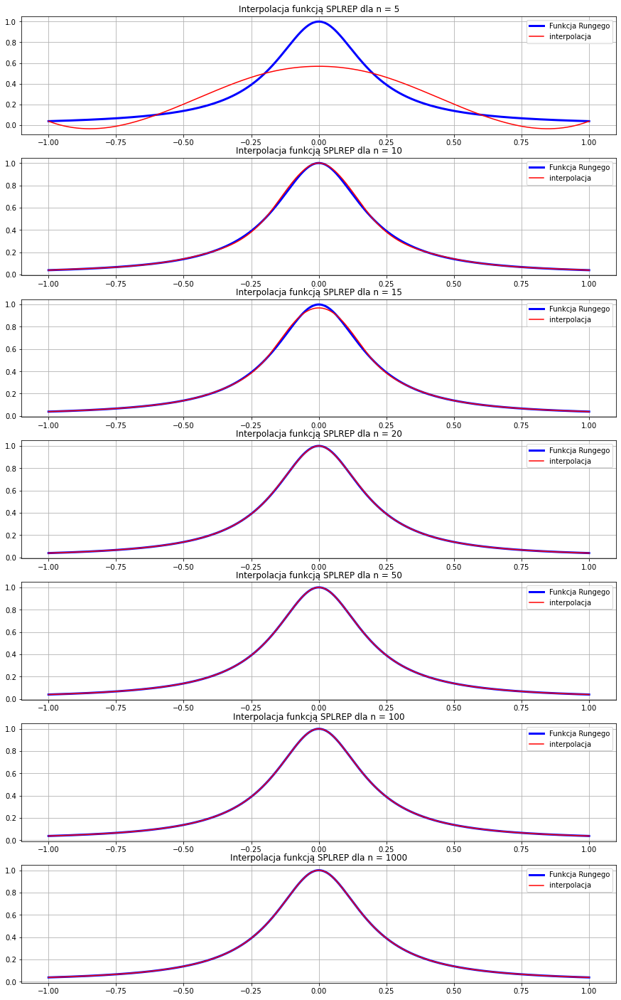

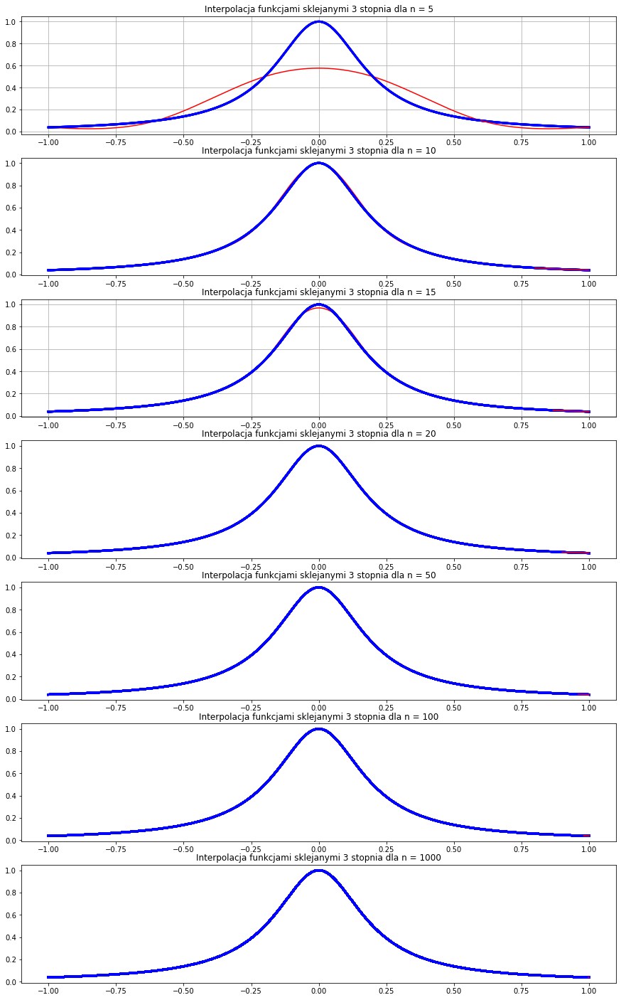

In [13]:
number_of_nodes = [5, 10, 15, 20, 50, 100, 1000]
f = lambda x: 1/(25*x**2+1)

### ANALIZA DZIAŁANIA POSZCZEGÓLNYCH FUNKCJI ###

j=0 #Zmienna przydatna do subplotowania


fig2, axs2 = plt.subplots(7, 1) #Tworzę subplot dla interpolacji SPLPREP
fig2.set_figheight(25) #Ustawiam wysokość figury subplota
fig2.set_figwidth(15) #Ustawiam szerokość figury subplota

fig3, axs3 = plt.subplots(7, 1) #Tworzę subplot dla interpolacji pierwszego stopnia 
fig3.set_figheight(25) #Ustawiam wysokość figury subplota
fig3.set_figwidth(15) #Ustawiam szerokość figury subplota

for n in number_of_nodes:
    x = np.linspace(-1, 1, n+1)
    y = f(x)
    t = np.linspace(-1,1,1000)


    # INTERPOLACJA SPLPREP
    spl = splrep(x,y,k=3)
    y_spl = splev(t,spl)
    axs2[j].plot(t, f(t), 'b', linewidth=3, label='Funkcja Rungego')
    axs2[j].plot(t,y_spl,'r',label='interpolacja')
    axs2[j].set(title = f"Interpolacja funkcją SPLREP dla n = {n}")
    axs2[j].grid()
    axs2[j].legend()

    
    ## INTERPOLACJA PIERWSZEGO STOPNIA
    a_0, a_1, a_2, a_3 = cubic_spline(x,y)
    coeffs = [[a_0[i],a_1[i],a_2[i],a_3[i]] for i in range(len(a_0))]
    for i in range(len(x)-1):
        x_new = np.linspace(x[i], x[i+1],1000)
        axs3[j].plot(t, f(t), 'b', linewidth=3)
        axs3[j].plot(x_new, PolyCoefficients(x_new, coeffs[i]),'r')
        axs3[j].set(title = f"Interpolacja funkcjami sklejanymi 3 stopnia dla n = {n}")
        axs3[j].grid()
    j=j+1

Można zauważyć, że dzięki zastosowaniu funkcji sklejanych wyższego stopnia (3 zamiast 1) interpolacja dużo szybciej dopasowuje się do funkcji. Jest to logiczne, gdyż odwzorowywana funckja ma dużo więcej wspólnego z wielomianem 3 stopnia niż 1. Dodatkowo warto zauważyć, że już dla n = 20 (a nie 50 jak to było wcześniej) interpolacja już bardzo dobrze odwzorowuje funkcję.

Badam jakość działania mojego algorytmu:

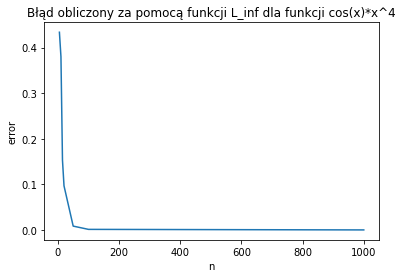

In [4]:
import matplotlib.pyplot as plt
from scipy.interpolate import splev, splrep
from typing import Union, List

def L_inf(xr:Union[int, float, List, np.ndarray],x:Union[int, float, List, np.ndarray])-> float:
    if type(xr) not in [int, float, list, np.ndarray] or type(x) not in [int, float, list, np.ndarray]: #ważne żeby było list a nie List bo to konkretny rodzaj z List
        return np.nan
    if type(x) is int and type(xr) is list:
        return np.nan 
    if type(xr) is int and type(x) is list:
        return np.nan  
    if type(x) is list and type(xr) is list:
        if len(x) == len(xr):
            return max([abs(x[i] - xr[i]) for i in range(len(x))])
        else: 
            return np.nan
    if type(x) is np.ndarray and type(xr) is np.ndarray and x.shape != xr.shape:
            return np.nan
    if type(x) is int and type(xr) is int:
        return abs(x-xr)
    if type(x) is int and type(xr) is np.ndarray or type(xr) is int and type(x) is np.ndarray: # ale w sumie dlaczego xd?
        return np.nan
    return max(abs(x-xr))

f1 = lambda x: 1/(25*x**2+1)
number_of_nodes = [5, 10, 15, 20, 50, 100, 1000]
errors = list()
for k in number_of_nodes:
    x = np.linspace(-1, 1, k+1)
    y = f1(x)
    a_0,a_1, a_2, a_3=main.cubic_spline(x,y)
    f = [[a_0[i],a_1[i],a_2[i],a_3[i]] for i in range(len(a_0))]
    y_new = []
    for i in range(len(x)-1):
        x_new = np.linspace(x[i], x[i+1],k)
        y_new.append(PolyCoefficients(x_new, f[i]))
    M = np.asarray(y_new).reshape(-1)
    x2 = np.linspace(-1, 1, len(M))
    y2 = f1(x2)
    err = L_inf(y2,M)
    errors.append(err)

fig, ax1 = plt.subplots()
ax1.plot(number_of_nodes,errors)
ax1.set(title="Błąd obliczony za pomocą funkcji L_inf dla funkcji cos(x)*x^4",xlabel='n',ylabel='error')
fig.show()

Błąd aproksymacji zmniejsza się szybciej niż błąd aproksymacji dla funkcji 1 stopnia, czego oczekiwaliśmy.

Badam złożoność obliczeniową funkcji:

13.4 ms ± 335 µs per loop (mean ± std. dev. of 2 runs, 2 loops each)


Memory usage for cubic spline: 
peak memory: 134.48 MiB, increment: 0.09 MiB
32.6 ms ± 42.2 µs per loop (mean ± std. dev. of 2 runs, 2 loops each)


Memory usage for cubic spline: 
peak memory: 134.48 MiB, increment: 0.00 MiB
58.6 ms ± 142 µs per loop (mean ± std. dev. of 2 runs, 2 loops each)


Memory usage for cubic spline: 
peak memory: 134.48 MiB, increment: 0.00 MiB
93.3 ms ± 1.09 ms per loop (mean ± std. dev. of 2 runs, 2 loops each)


Memory usage for cubic spline: 
peak memory: 134.48 MiB, increment: 0.00 MiB
456 ms ± 701 µs per loop (mean ± std. dev. of 2 runs, 2 loops each)


Memory usage for cubic spline: 
peak memory: 134.48 MiB, increment: 0.00 MiB
1.71 s ± 9.71 ms per loop (mean ± std. dev. of 2 runs, 2 loops each)


Memory usage for cubic spline: 
peak memory: 134.48 MiB, increment: 0.00 MiB
2min 35s ± 90.6 ms per loop (mean ± std. dev. of 2 runs, 2 loops each)


Memory usage for cubic spline: 
peak m

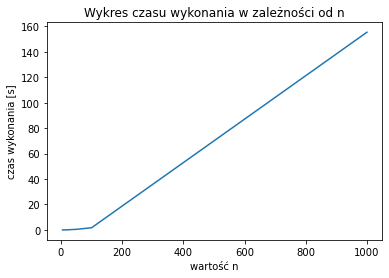

In [5]:
%load_ext memory_profiler

time_vector =list()
dev_vector=list()
number_of_nodes = [5, 10, 15, 20, 50, 100, 1000]
f = lambda x: 1/(25*x**2+1)
for n in number_of_nodes:
    x = np.linspace(-1, 1, n+1)
    y = f(x)
    f_spl_timing = %timeit -r 2 -n 2 -o cubic_spline(x,y)
    time_vector.append(f_spl_timing.average)   # średni czas próby
    dev_vector.append(f_spl_timing.stdev)     # odchylenie standardowe
    print('\n\nMemory usage for cubic spline: ')
    %memit cubic_spline(x,y) #możemy zaobserować, że użycie pamięci jest niezależne od n
 

fig, ax1 = plt.subplots()
ax1.plot(number_of_nodes,time_vector)
ax1.set(title="Wykres czasu wykonania w zależności od n",xlabel='wartość n',ylabel='czas wykonania [s]') #wykres jest liniowy, można więc założyć, że złożoność obliczeniowa algorytmu jest także liniowa O(n)
fig.show()

Ponownie ilość zajomowanego miejsca nie zależy od n. Złożoność czasowa algorytmu jest liniowa. Dla n = 1000 średni czas liczenia wynosi około 2.5 min.

***Zadanie 6.***  
Korzystając z funkcji z pakietu [scipy.interpolate.splprep](https://docs.scipy.org/doc/scipy/reference/generated/scipy.interpolate.splprep.html#scipy.interpolate.splprep), funkcji zaimplementowanej w Zadaniu 4: 
    
### $ f(x) = cos(x)x^4$

W przedziale \[-1, 1\]

dla różnych ilości wartości węzłów: 5, 10, 15, 20, 50, 100, 1000

Dokonaj porównania wyników otrzymanych:  
Wykorzystując funkcję z ubiegłego tygodnia, ocenić jakość interpolacji funkcji spline pierwszego stopnia z wartościami danej funkcji.
Sprawdź czas wykonywania się poszczególnych elementów oraz ilość pamięci użytej 


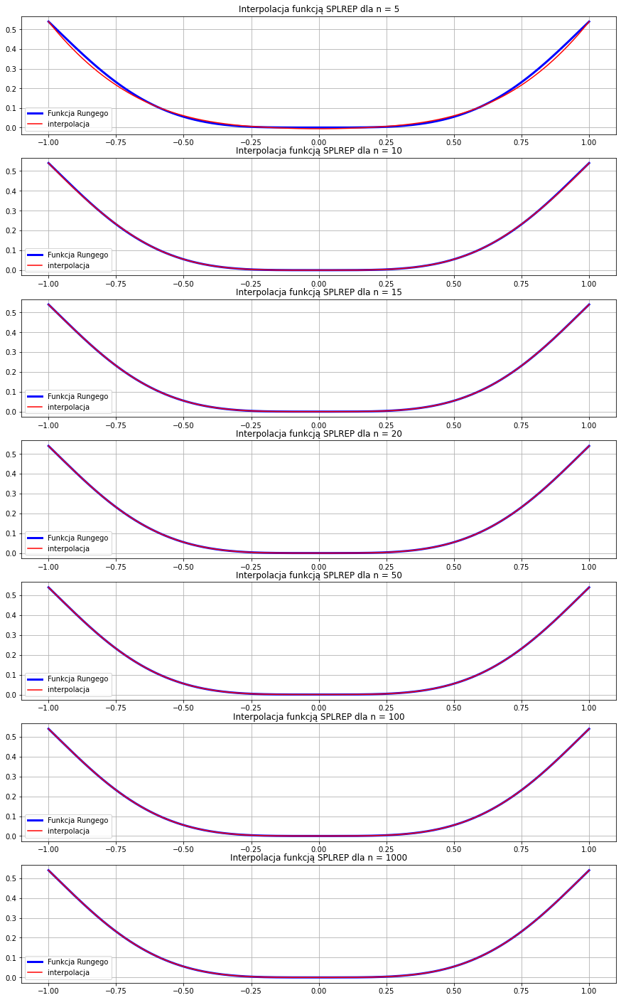

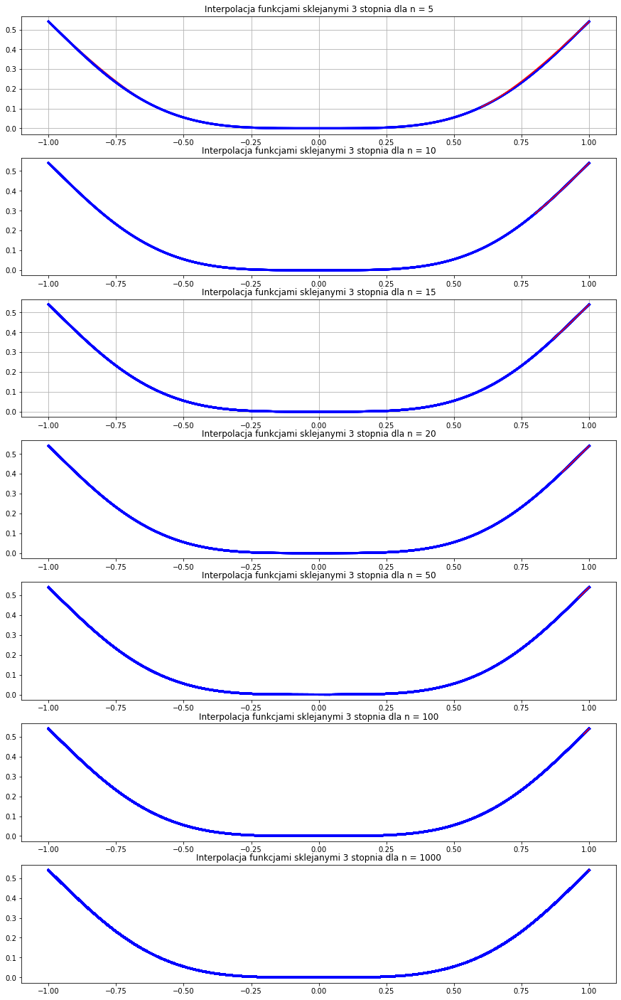

In [25]:
number_of_nodes = [5, 10, 15, 20, 50, 100, 1000]
f = lambda x: np.cos(x)*x**4

### ANALIZA DZIAŁANIA POSZCZEGÓLNYCH FUNKCJI ###

j=0 #Zmienna przydatna do subplotowania


fig2, axs2 = plt.subplots(7, 1) #Tworzę subplot dla interpolacji SPLPREP
fig2.set_figheight(25) #Ustawiam wysokość figury subplota
fig2.set_figwidth(15) #Ustawiam szerokość figury subplota

fig3, axs3 = plt.subplots(7, 1) #Tworzę subplot dla interpolacji pierwszego stopnia 
fig3.set_figheight(25) #Ustawiam wysokość figury subplota
fig3.set_figwidth(15) #Ustawiam szerokość figury subplota

for n in number_of_nodes:
    x = np.linspace(-1, 1, n+1)
    y = f(x)
    t = np.linspace(-1,1,1000)


    # INTERPOLACJA SPLPREP
    spl = splrep(x,y,k=3)
    y_spl = splev(t,spl)
    axs2[j].plot(t, f(t), 'b', linewidth=3, label='Funkcja Rungego')
    axs2[j].plot(t,y_spl,'r',label='interpolacja')
    axs2[j].set(title = f"Interpolacja funkcją SPLREP dla n = {n}")
    axs2[j].grid()
    axs2[j].legend()

    
    ## INTERPOLACJA PIERWSZEGO STOPNIA
    a_0, a_1, a_2, a_3 = cubic_spline(x,y)
    coeffs = [[a_0[i],a_1[i],a_2[i],a_3[i]] for i in range(len(a_0))]
    for i in range(len(x)-1):
        x_new = np.linspace(x[i], x[i+1],1000)
        axs3[j].plot(t, f(t), 'b', linewidth=3)
        axs3[j].plot(x_new, PolyCoefficients(x_new, coeffs[i]),'r')
        axs3[j].set(title = f"Interpolacja funkcjami sklejanymi 3 stopnia dla n = {n}")
        axs3[j].grid()
    j=j+1

Sprawdzam jakość działania algorytmu:

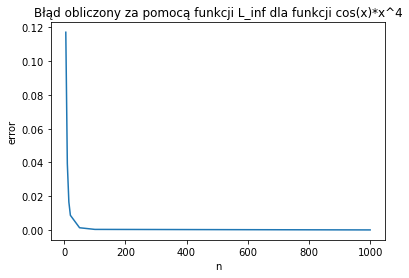

In [6]:
import matplotlib.pyplot as plt
from scipy.interpolate import splev, splrep
from typing import Union, List

def L_inf(xr:Union[int, float, List, np.ndarray],x:Union[int, float, List, np.ndarray])-> float:
    if type(xr) not in [int, float, list, np.ndarray] or type(x) not in [int, float, list, np.ndarray]: #ważne żeby było list a nie List bo to konkretny rodzaj z List
        return np.nan
    if type(x) is int and type(xr) is list:
        return np.nan 
    if type(xr) is int and type(x) is list:
        return np.nan  
    if type(x) is list and type(xr) is list:
        if len(x) == len(xr):
            return max([abs(x[i] - xr[i]) for i in range(len(x))])
        else: 
            return np.nan
    if type(x) is np.ndarray and type(xr) is np.ndarray and x.shape != xr.shape:
            return np.nan
    if type(x) is int and type(xr) is int:
        return abs(x-xr)
    if type(x) is int and type(xr) is np.ndarray or type(xr) is int and type(x) is np.ndarray: # ale w sumie dlaczego xd?
        return np.nan
    return max(abs(x-xr))

f1 = lambda x: np.cos(x)*x**4
number_of_nodes = [5, 10, 15, 20, 50, 100, 1000]
errors = list()
for k in number_of_nodes:
    x = np.linspace(-1, 1, k+1)
    y = f1(x)
    a_0,a_1, a_2, a_3=main.cubic_spline(x,y)
    f = [[a_0[i],a_1[i],a_2[i],a_3[i]] for i in range(len(a_0))]
    y_new = []
    for i in range(len(x)-1):
        x_new = np.linspace(x[i], x[i+1],k)
        y_new.append(PolyCoefficients(x_new, f[i]))
    M = np.asarray(y_new).reshape(-1)
    x2 = np.linspace(-1, 1, len(M))
    y2 = f1(x2)
    err = L_inf(y2,M)
    errors.append(err)

fig, ax1 = plt.subplots()
ax1.plot(number_of_nodes,errors)
ax1.set(title="Błąd obliczony za pomocą funkcji L_inf dla funkcji cos(x)*x^4",xlabel='n',ylabel='error')
fig.show()

In [ ]:
Badam złożoność obliczeniową algorytmu:

The memory_profiler extension is already loaded. To reload it, use:
  %reload_ext memory_profiler
13.7 ms ± 28 µs per loop (mean ± std. dev. of 2 runs, 2 loops each)


Memory usage for cubic spline: 
peak memory: 131.48 MiB, increment: 0.00 MiB
32.3 ms ± 105 µs per loop (mean ± std. dev. of 2 runs, 2 loops each)


Memory usage for cubic spline: 
peak memory: 131.48 MiB, increment: 0.00 MiB
57 ms ± 319 µs per loop (mean ± std. dev. of 2 runs, 2 loops each)


Memory usage for cubic spline: 
peak memory: 122.11 MiB, increment: 0.00 MiB
93.5 ms ± 140 µs per loop (mean ± std. dev. of 2 runs, 2 loops each)


Memory usage for cubic spline: 
peak memory: 122.11 MiB, increment: 0.00 MiB
462 ms ± 288 µs per loop (mean ± std. dev. of 2 runs, 2 loops each)


Memory usage for cubic spline: 
peak memory: 122.12 MiB, increment: 0.00 MiB
1.7 s ± 6.29 ms per loop (mean ± std. dev. of 2 runs, 2 loops each)


Memory usage for cubic spline: 
peak memory: 122.13 MiB, increment: 0.00 MiB
2min 36s ± 840 ms p

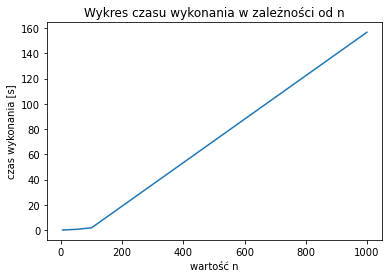

In [7]:
%load_ext memory_profiler

time_vector =list()
dev_vector=list()
number_of_nodes = [5, 10, 15, 20, 50, 100, 1000]
f = lambda x: np.cos(x)*x**4
for n in number_of_nodes:
    x = np.linspace(-1, 1, n+1)
    y = f(x)
    f_spl_timing = %timeit -r 2 -n 2 -o cubic_spline(x,y)
    time_vector.append(f_spl_timing.average)   # średni czas próby
    dev_vector.append(f_spl_timing.stdev)     # odchylenie standardowe
    print('\n\nMemory usage for cubic spline: ')
    %memit cubic_spline(x,y) #możemy zaobserować, że użycie pamięci jest niezależne od n
 


fig, ax1 = plt.subplots()
ax1.plot(number_of_nodes,time_vector)
ax1.set(title="Wykres czasu wykonania w zależności od n",xlabel='wartość n',ylabel='czas wykonania [s]') #wykres jest liniowy, można więc założyć, że złożoność obliczeniowa algorytmu jest także liniowa O(n)
fig.show()

***Zadanie 7.***  
Dla funkcji:
### $f(x) = |sin(5x)|^3$

Porównać działanie funkcji zaimplementowanych w Zadaniu 1 oraz 4 dla różnych ilości wartości węzłów: 5, 10, 15, 20, 50, 100, 1000 oraz przedstawić wyniki na odpowiednich wykresach.



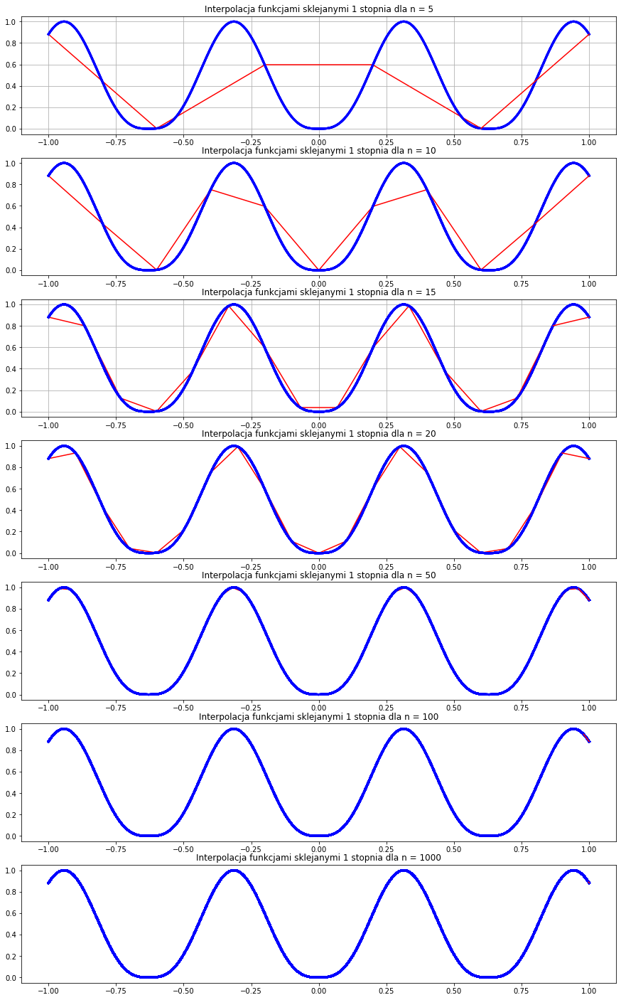

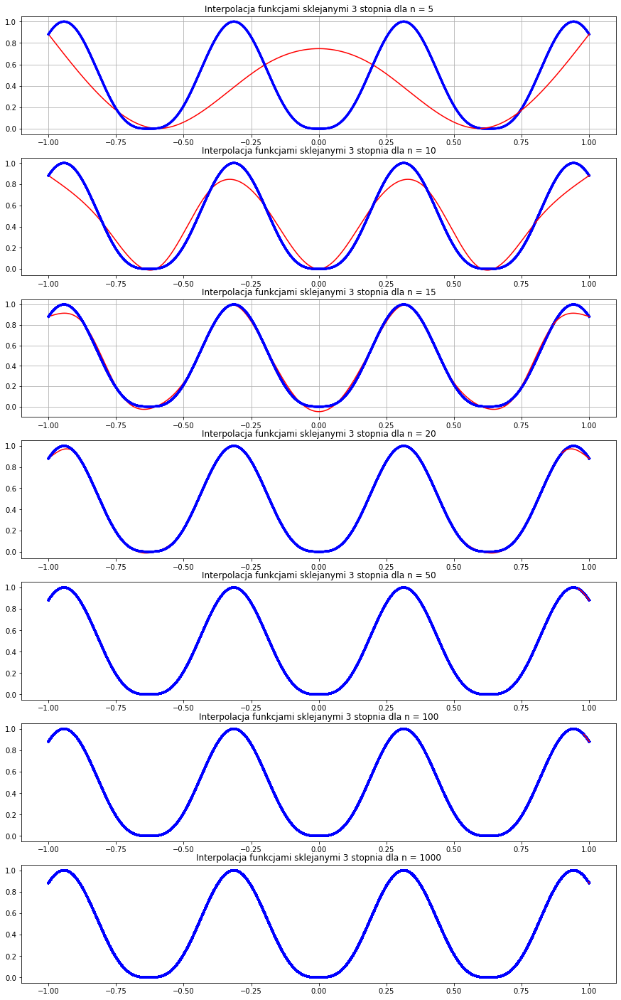

In [10]:
f = lambda x: np.abs(np.sin(5*x))**3

number_of_nodes = [5, 10, 15, 20, 50, 100, 1000]

### ANALIZA DZIAŁANIA POSZCZEGÓLNYCH FUNKCJI ###

j=0 #Zmienna przydatna do subplotowania


fig2, axs2 = plt.subplots(7, 1) #Tworzę subplot dla interpolacji SPLPREP
fig2.set_figheight(25) #Ustawiam wysokość figury subplota
fig2.set_figwidth(15) #Ustawiam szerokość figury subplota

fig3, axs3 = plt.subplots(7, 1) #Tworzę subplot dla interpolacji pierwszego stopnia 
fig3.set_figheight(25) #Ustawiam wysokość figury subplota
fig3.set_figwidth(15) #Ustawiam szerokość figury subplota

for n in number_of_nodes:
    x = np.linspace(-1, 1, n+1)
    y = f(x)
    t = np.linspace(-1,1,1000)


    ## INTERPOLACJA PIERWSZEGO STOPNIA
    a_first, b_first = first_spline(x,y)
    coeffs = [[b_first[i],a_first[i]] for i in range(len(a_first))]
    for i in range(len(x)-1):
        x_new = np.linspace(x[i], x[i+1],1000)
        axs2[j].plot(t, f(t), 'b', linewidth=3)
        axs2[j].plot(x_new, PolyCoefficients(x_new, coeffs[i]),'r')
        axs2[j].set(title = f"Interpolacja funkcjami sklejanymi 1 stopnia dla n = {n}")
        axs2[j].grid()
    

    
    ## INTERPOLACJA TRZECIEGO STOPNIA
    a_0, a_1, a_2, a_3 = cubic_spline(x,y)
    coeffs = [[a_0[i],a_1[i],a_2[i],a_3[i]] for i in range(len(a_0))]
    for i in range(len(x)-1):
        x_new = np.linspace(x[i], x[i+1],1000)
        axs3[j].plot(t, f(t), 'b', linewidth=3)
        axs3[j].plot(x_new, PolyCoefficients(x_new, coeffs[i]),'r')
        axs3[j].set(title = f"Interpolacja funkcjami sklejanymi 3 stopnia dla n = {n}")
        axs3[j].grid()
    j=j+1

Wnioski: Można zauważyć, że dla interpolacji funkcjami sklejanymi 3 stopnia już dla n=20 mamy całkiem dobre dopasowanie.